In [2]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import warnings
warnings.filterwarnings("ignore")

In [3]:
df = pd.read_csv("churn.csv")
df.head()

,Unnamed: 0,id,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,churn
0,0,106473,15639576,Sarratt,652.0,France,Female,65.0,3,0.00,2,1,1,136592.24,0
1,1,62345,15769582,Hanson,464.0,France,Male,35.0,4,0.00,1,0,0,99505.75,1
2,2,126615,15675888,Austin,620.0,Germany,Female,39.0,6,129401.87,2,1,1,102681.32,1
3,3,35909,15786617,Tuan,598.0,France,Female,30.0,7,0.00,2,1,0,141210.18,0
4,4,45175,15757310,Li Fonti,682.0,Germany,Female,46.0,4,107720.57,1,0,0,93832.33,1


In [4]:
df["CreditScore"] = df["CreditScore"].fillna(df["CreditScore"].mean())
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41259 entries, 0 to 41258
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       41259 non-null  int64  
 1   id               41259 non-null  int64  
 2   CustomerId       41259 non-null  int64  
 3   Surname          41259 non-null  object 
 4   CreditScore      41259 non-null  float64
 5   Geography        41259 non-null  object 
 6   Gender           41259 non-null  object 
 7   Age              41259 non-null  float64
 8   Tenure           41259 non-null  int64  
 9   Balance          41259 non-null  float64
 10  NumOfProducts    41259 non-null  int64  
 11  HasCrCard        41259 non-null  int64  
 12  IsActiveMember   41259 non-null  int64  
 13  EstimatedSalary  41259 non-null  float64
 14  churn            41259 non-null  int64  
dtypes: float64(4), int64(8), object(3)
memory usage: 4.7+ MB


In [4]:
df.duplicated().sum()

0

In [5]:
df.drop(columns=["Unnamed: 0","id","CustomerId","Surname"], inplace=True)
df.head()  

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,churn
0,652.0,France,Female,65.0,3,0.00,2,1,1,136592.24,0
1,464.0,France,Male,35.0,4,0.00,1,0,0,99505.75,1
2,620.0,Germany,Female,39.0,6,129401.87,2,1,1,102681.32,1
3,598.0,France,Female,30.0,7,0.00,2,1,0,141210.18,0
4,682.0,Germany,Female,46.0,4,107720.57,1,0,0,93832.33,1


In [6]:
discrete_columns = ["Tenure", "NumOfProducts", "HasCrCard", "IsActiveMember", "churn"]
discrete_columns.extend(df.select_dtypes("object").columns.tolist())

unique = [df[name].value_counts() for name in discrete_columns]
unique

[Tenure
 2     4588
 4     4442
 7     4431
 5     4291
 8     4232
 3     4231
 1     4177
 9     4173
 6     3970
 10    1474
 0     1250
 Name: count, dtype: int64,
 NumOfProducts
 2    21132
 1    19316
 3      694
 4      117
 Name: count, dtype: int64,
 HasCrCard
 1    31126
 0    10133
 Name: count, dtype: int64,
 IsActiveMember
 0    20767
 1    20492
 Name: count, dtype: int64,
 churn
 0    32540
 1     8719
 Name: count, dtype: int64,
 Geography
 France     23520
 Spain       9081
 Germany     8658
 Name: count, dtype: int64,
 Gender
 Male      23166
 Female    18093
 Name: count, dtype: int64]

In [7]:
for col in df.select_dtypes(include="number").columns:
    print(f"the range of col-{col} uis between {df[col].min()} to {df[col].max()}")

the range of col-CreditScore uis between 350.0 to 850.0
the range of col-Age uis between 18.0 to 92.0
the range of col-Tenure uis between 0 to 10
the range of col-Balance uis between 0.0 to 250898.09
the range of col-NumOfProducts uis between 1 to 4
the range of col-HasCrCard uis between 0 to 1
the range of col-IsActiveMember uis between 0 to 1
the range of col-EstimatedSalary uis between 11.58 to 199992.48
the range of col-churn uis between 0 to 1


# Visualization

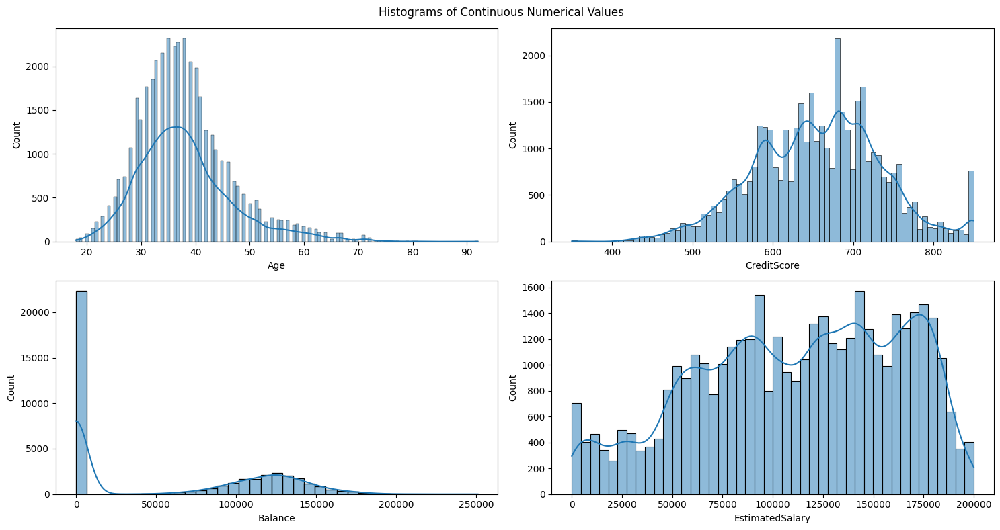

In [37]:
fig, axes = plt.subplots(2,2, figsize=(15,8))
cols = ["Age","CreditScore","Balance" ,"EstimatedSalary"]
axes = axes.flatten()

for ax, col in zip(axes, cols):
    sns.histplot(data=df, x=col, ax=ax, kde= True)

fig.suptitle("Histograms of Continuous Numerical Values")
plt.tight_layout()

In [52]:
fig = make_subplots(rows=2, cols=4, subplot_titles=discrete_columns,
                    specs=[[{'type':'domain'}]*4]*2) 

for i, cols in enumerate(discrete_columns):
    row = i // 4 + 1
    col = i % 4 + 1

    pie_chart = go.Pie(labels=df[cols].value_counts().index,
                       values=df[cols].value_counts().values,
                       name=cols)
    fig.add_trace(pie_chart, row=row, col=col)

fig.update_layout(
    title_text="Distribution of Discrete Variables",
    showlegend=False,
    height=800,
    width=1100
)
fig.show()

In [12]:
fig1 = px.scatter(df, x="Age", y="CreditScore", color="churn", size_max=10, opacity=0.7,
                 hover_data=["Geography", "Tenure", "NumOfProducts", "IsActiveMember", "EstimatedSalary"])

fig2 = px.scatter(df, x="Age", y="Balance", color="churn", size_max=10, opacity=0.7,
                 hover_data=["Geography", "Tenure", "NumOfProducts", "IsActiveMember", "CreditScore"])

fig3 = px.scatter(df, x="Balance", y="CreditScore", color="churn", size_max=10, opacity=0.7,
                 hover_data=["Geography", "Tenure", "NumOfProducts", "IsActiveMember", "Age"])

fig = fig1  
fig.add_traces(fig2.data)
fig.add_traces(fig3.data)

fig.update_layout(
    updatemenus=[{
        'buttons': [
            {
                'label': 'Age x CreditScore',
                'method': 'update',
                'args': [{'visible': [True, False, False, False]}]
            },
            {
                'label': 'Age x Balance',
                'method': 'update',
                'args': [{'visible': [False, True, False, False]}]
            },
            {
                'label': 'Balance x CreditScore',
                'method': 'update',
                'args': [{'visible': [False, False, False, True]}]
            }
        ],
        'direction': 'down',
        'showactive': True
    }],
    title='Relationship Between Features and Churn'
)

fig.show()


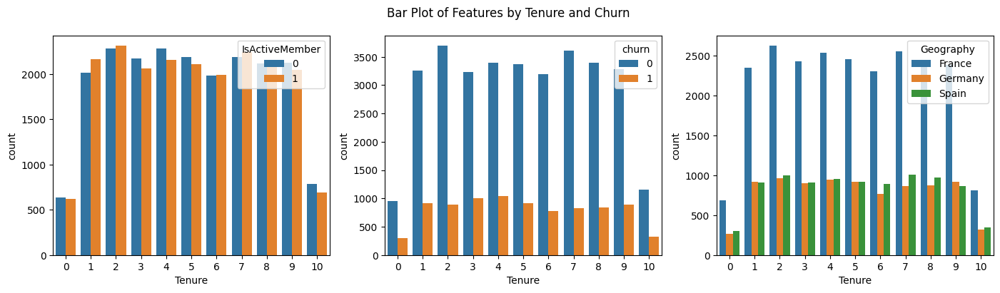

In [24]:
cols =["IsActiveMember", "churn", "Geography"]
fig, axes = plt.subplots(1,3, figsize=(17,4))
axes = axes.flatten()

for ax, col in zip(axes, cols): 
    sns.countplot(data=df, x='Tenure', hue=col, ax=ax)

fig.suptitle('Bar Plot of Features by Tenure and Churn')
plt.show()

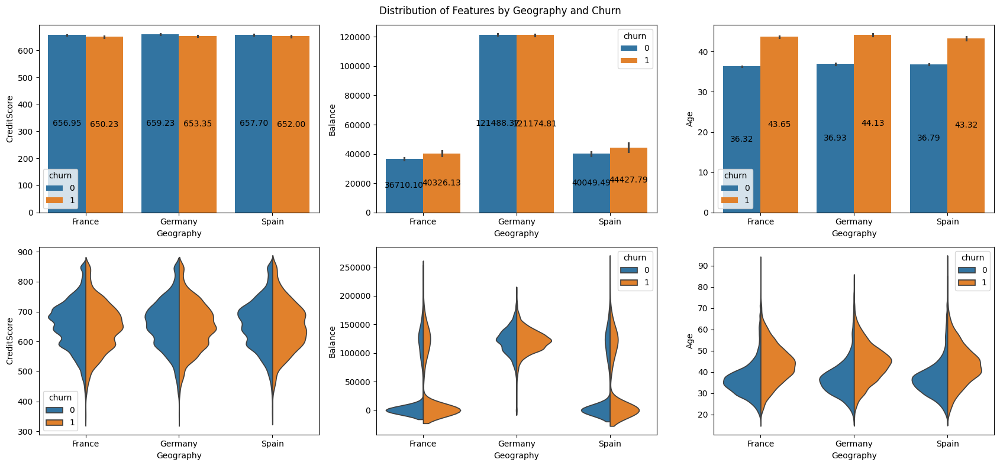

In [25]:
cols = ["CreditScore", "Balance", "Age"]
fig, axes = plt.subplots(2, 3, figsize=(17, 8))
axes = axes.flatten()

for ax, col in zip(axes[:3], cols):
    sns.barplot(data=df, x='Geography', y=col, hue="churn", ax=ax)
    for container in ax.containers:
        ax.bar_label(container, fmt='%.2f', label_type='center')

for ax, col in zip(axes[3:], cols):
    sns.violinplot(data=df, x='Geography', y=col, hue="churn", split=True, ax=ax)

    for line in ax.lines:
        line.remove()

fig.suptitle('Distribution of Features by Geography and Churn')
plt.tight_layout() 
plt.show()
